In [1]:
import itertools
import cv2
import otsu
import matplotlib.pyplot as plt
import numpy as np
import glob
import math
from PlotToImage import PlotToImage
from auto_tsmo import full_method
import time
import json

In [168]:
def ImShow(im, size=(14,17)):
    plt.figure(figsize = size)
    plt.imshow(im, 'gray', vmin = 0, vmax = 255)
    plt.show()

def HistPlot(vals, size=(14,17)):
    plt.figure(figsize = size)
    plt.plot(np.arange(len(vals)), vals)
    plt.show()

In [15]:
video_dataset = {}
with open("video_groundtruth.json", "r") as read_file:
    video_dataset = json.load(read_file)
FLIR_dataset = {}
with open("FLIR_val_groundtruth.json", "r") as read_file:
    FLIR_dataset = json.load(read_file)
# FLIR_dataset = {}
# with open("FLIR_train_groundtruth.json", "r") as read_file:
#     FLIR_dataset = json.load(read_file)

In [16]:
all_data = np.append(list(video_dataset.keys()), list(FLIR_dataset.keys()))
np.random.shuffle(all_data)
all_data = all_data[:100]
# all_data

In [130]:
def getConts(path):
    if path in FLIR_dataset:
        contours = FLIR_dataset[path]
    else:
        contours = video_dataset[path]
    return contours

def drawContours(frame, rects):
    for rect in rects:
        x,y,w,h = rect
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0,255,0), 2)
        
def Normalize(gray):
    clahe = cv2.createCLAHE(clipLimit=10.0, tileGridSize=(8,8))
    return clahe.apply(gray)

In [157]:
def histCalc(gray):
    hist = np.array([np.sum([gray[j,i] for j in range(gray.shape[0])]) for i in range(gray.shape[1])])
    hist = hist / max(1,hist.max())
    return hist

def histCalc(gray):
    return np.histogram(gray, np.arange(257), density = True)[0]

In [158]:
SampleHist = []

In [193]:
def Show(gray, x, y , w, h): 
    cv2.rectangle(gray, (x, y), (x+w, y+h), (0,255,0), 1)
    ImShow(gray)
    
def Slide(gray):
    w = 24
    h = 48
    for x in range(0,gray.shape[0],w//4):
        for y in range(0,gray.shape[1],h//4):
            if y + h > gray.shape[1] or x + w > gray.shape[0]:
                break
            Show(gray.copy(), x, y, w, h)
            roi = gray[y:y+h,x:x+w]
            hist = histCalc(roi)
            HistPlot(hist)
            
def Show(gray, x, y , w, h): 
    cv2.rectangle(gray, (x, y), (x+w, y+h), (0,255,0), 1)
    cv2.imshow("slide", gray)

def Slide(gray):
    w = 24
    h = 48
    for x in range(0,gray.shape[0],w//4):
        for y in range(0,gray.shape[1],h//4):
            if y + h > gray.shape[1] or x + w > gray.shape[0]:
                break
            Show(gray.copy(), x, y, w, h)
            roi = gray[y:y+h,x:x+w]
            hist = histCalc(roi)
          #  HistPlot(hist)
            plot = PlotToImage(np.arange(hist.__len__()), hist)
            cv2.imshow("plot", plot)
            if cv2.waitKey(10000) & 0xFF == ord('q'):
                break

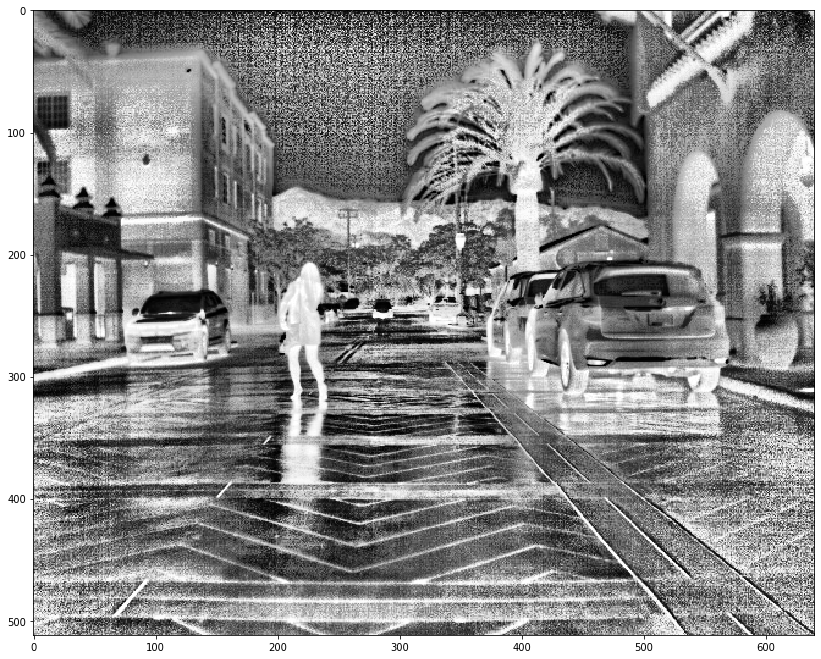

AttributeError: 'numpy.ndarray' object has no attribute 'append'

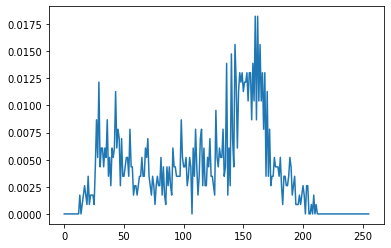

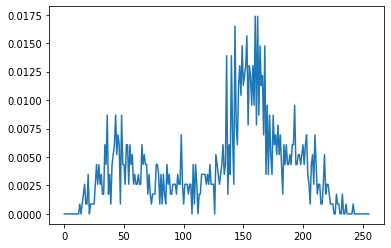

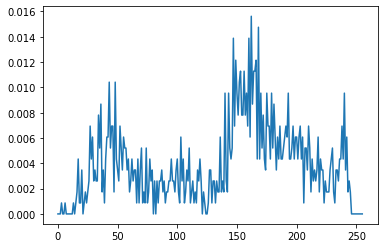

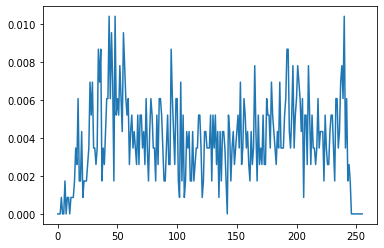

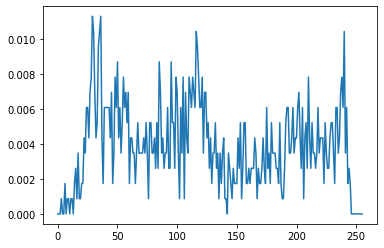

...

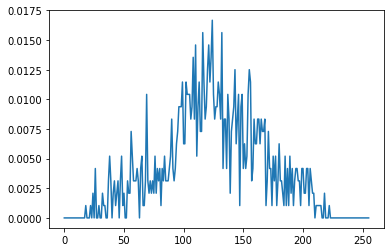

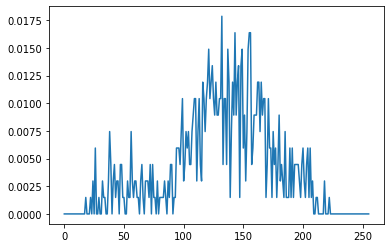

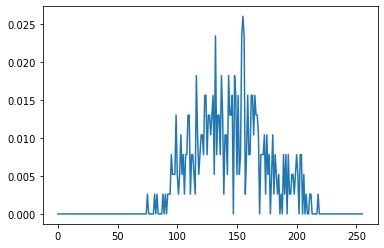

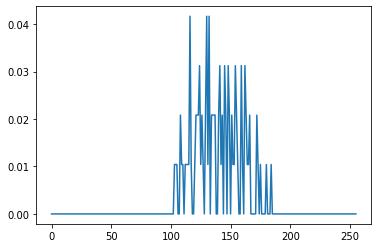

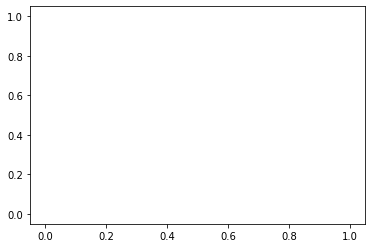

In [194]:
for path in all_data:
    frame = cv2.imread(path)
  #  frame = cv2.resize(frame, (320,240))
    
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    gray = Normalize(gray)
    
    ImShow(gray)
    new = cv2.pyrDown(gray)
    
    Slide(new)
   
    thresh = cv2.threshold(gray, 220, 255, cv2.THRESH_BINARY)[1]
    cv2.imshow("thresh", thresh)
    rects = getConts(path)
    
    for rect in rects:
        x,y,w,h = rect
        roi = gray[y:y+h,x:x+w]
    #    ImShow(roi)
#         print(roi.mean())
        hist = histCalc(roi)
   #     HistPlot(hist)
        SampleHist.append(hist)
        
        
  #  drawContours(frame, rects)
    
   # cv2.imshow("cnts", frame)
    
    
    
    if cv2.waitKey(100000) & 0xFF == ord('q'):
        break
cv2.destroyAllWindows()

In [164]:
SampleHist = np.mean(SampleHist, 0)

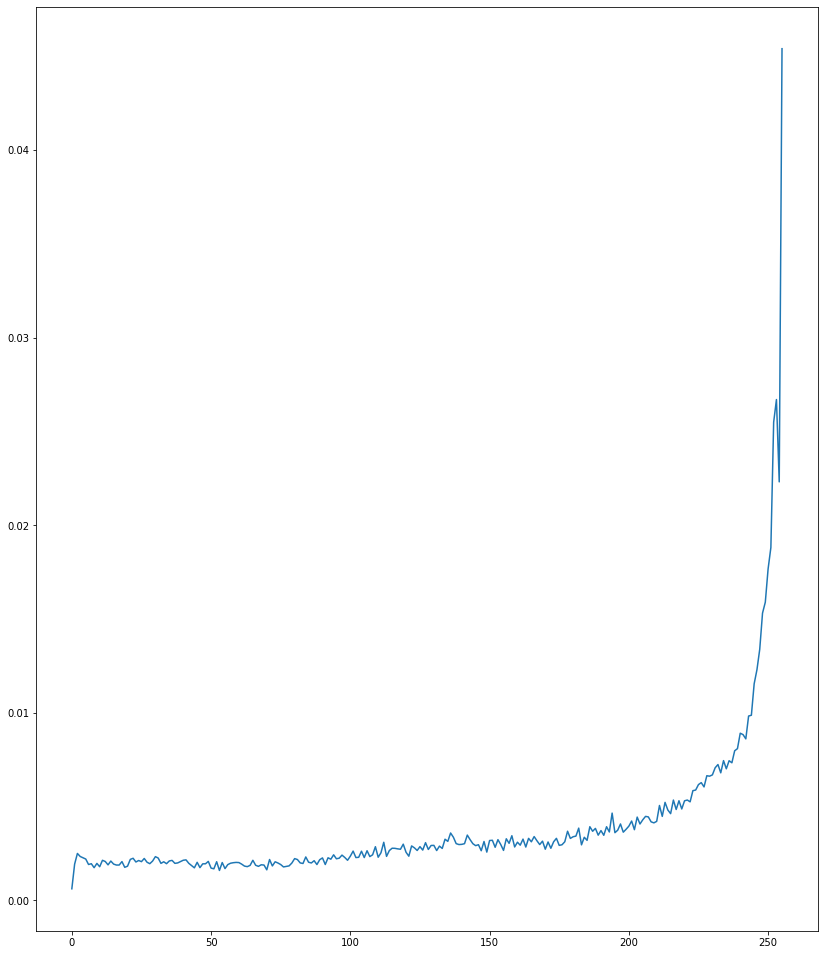

In [170]:
HistPlot(SampleHist)

In [ ]:
ImShow(cv2.resize(gray[15:-15,35:-35], (320,240)))

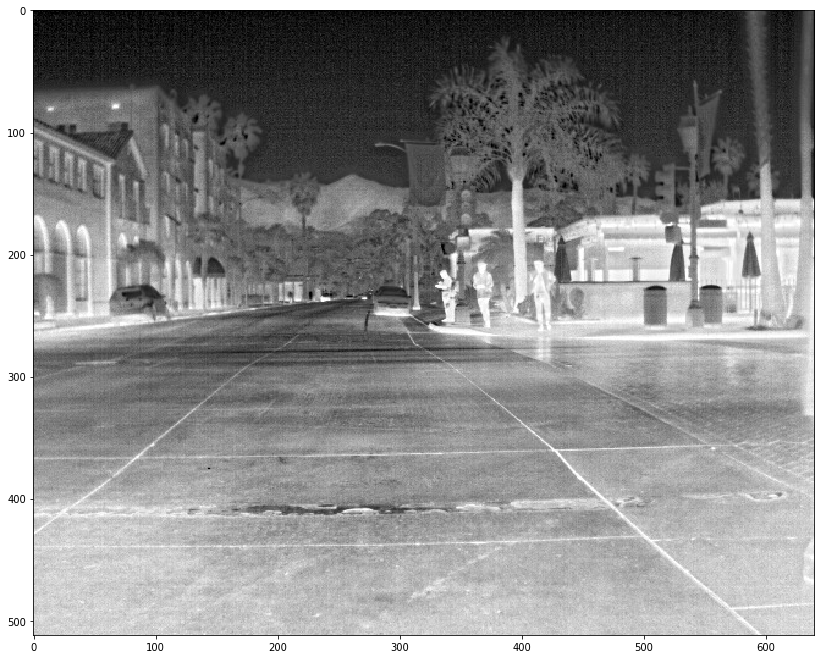

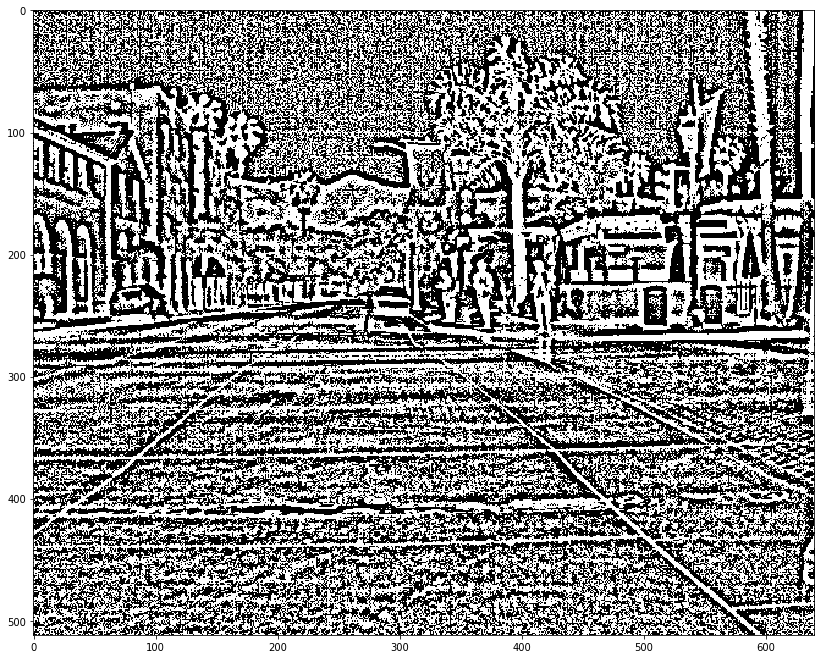

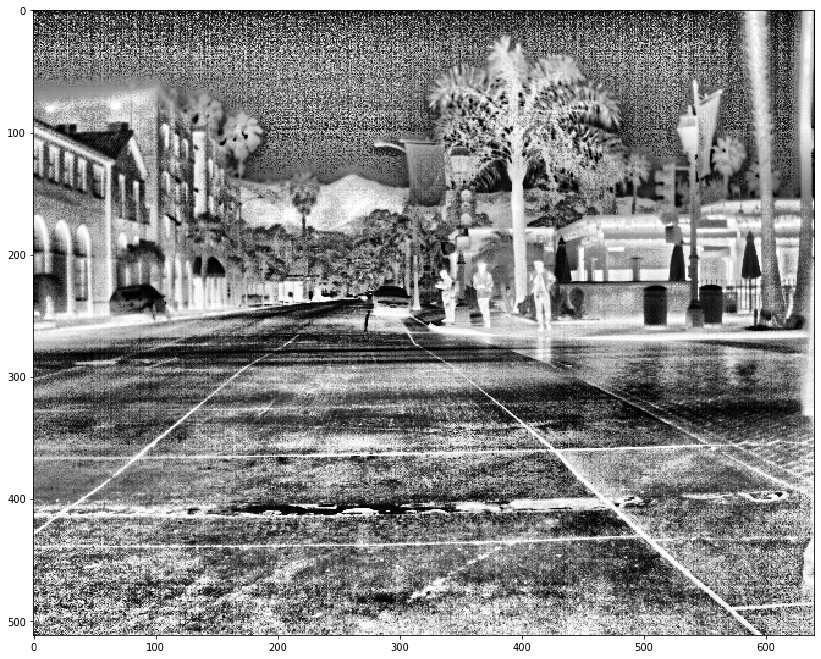

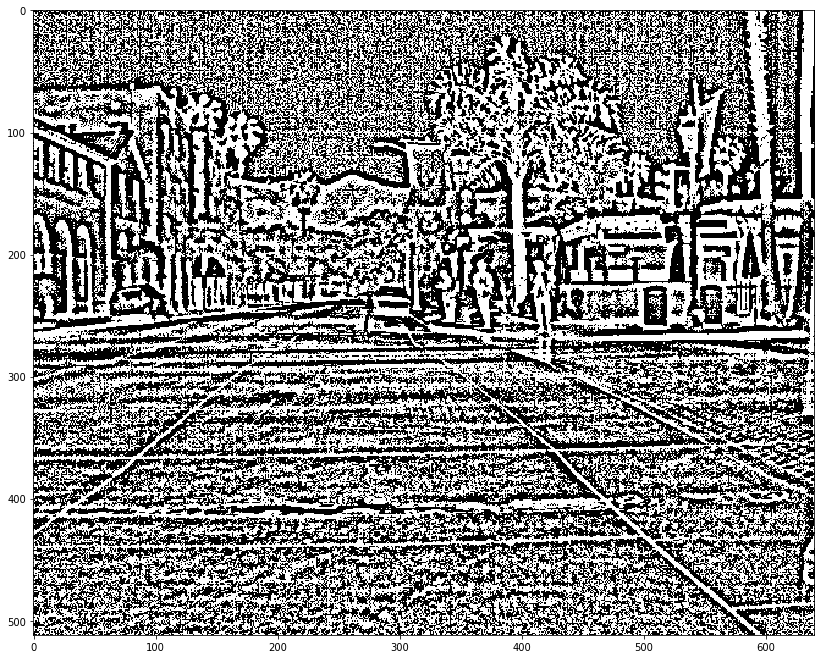

In [49]:
clahe = cv2.createCLAHE(clipLimit=10.0, tileGridSize=(8,8))
cl1 = clahe.apply(gray)
ImShow(gray)
thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY)[1]
thresh = cv2.adaptiveThreshold(gray,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,11,1)
ImShow(thresh)
ImShow(cl1)
thresh = cv2.threshold(cl1, 200, 255, cv2.THRESH_BINARY)[1]
thresh = cv2.adaptiveThreshold(gray,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,11,1)
ImShow(thresh)

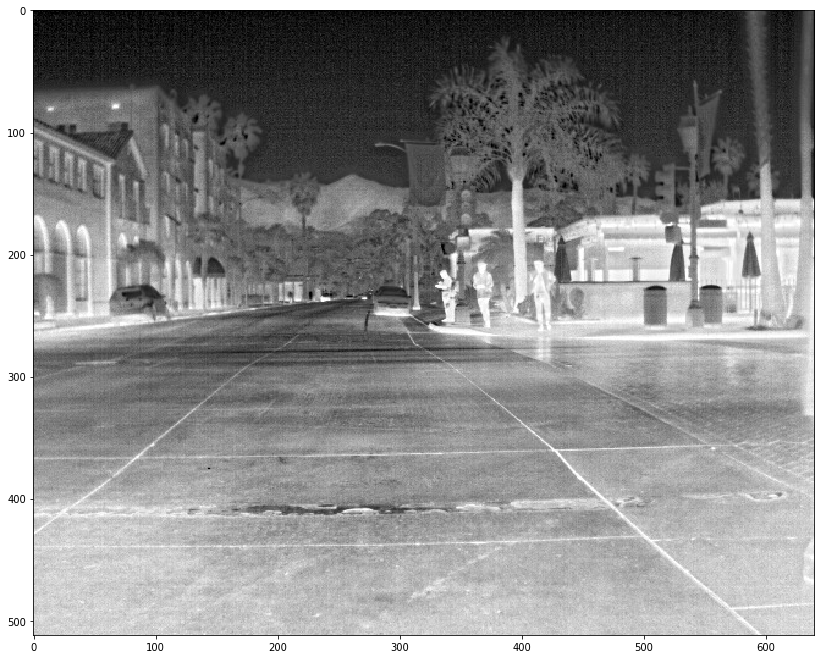

In [23]:
ImShow(gray)